In [1]:
!pip install -q diffusers==0.31.0 transformers accelerate safetensors torch torchvision


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 77.3 MB/s eta 0:00:00


model_index.json:   0%|          | 0.00/685 [00:00<?, ?B/s]

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

tokenizer_config.json:   0%|          | 0.00/704 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/586 [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/459 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/607 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


  0%|          | 0/4 [00:00<?, ?it/s]

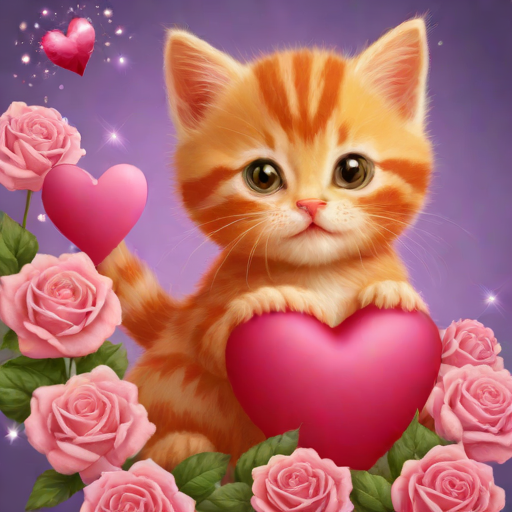

In [ ]:
import torch
from diffusers import StableDiffusionXLPipeline

pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/sdxl-turbo",
    torch_dtype=torch.float16,
    use_safetensors=True
).to("cuda")

prompt = "cute orange kitten smiling and holding a big red heart, surrounded by pink roses and sparkles"
image = pipe(prompt, num_inference_steps=4, guidance_scale=0.5).images[0]
image.save("image.png")
image


  0%|          | 0/4 [00:00<?, ?it/s]

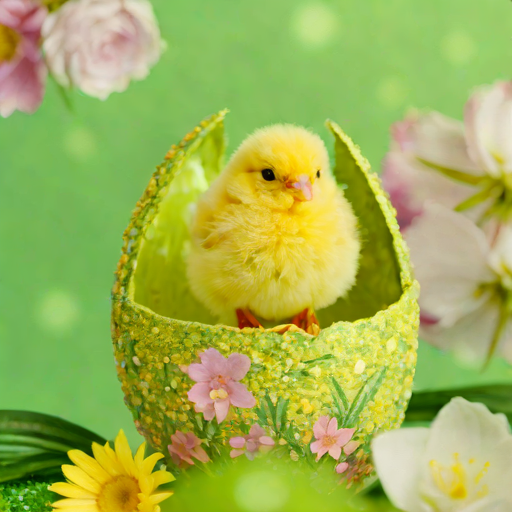

In [ ]:
prompt1 = "yellow chick emerging from decorated egg shell, surrounded by spring flowers, pastel pink and green background, glitter sparkles, glossy highlights, photomontage postcard style, no text"
image = pipe(prompt1, num_inference_steps=4, guidance_scale=0.5).images[0]
image.save("image.png")
image

model_index.json:   0%|          | 0.00/685 [00:00<?, ?B/s]

Fetching 18 files:   0%|          | 0/18 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/586 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/459 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/704 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/855 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/607 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


SDXL-StickerSheet-Lora.safetensors:   0%|          | 0.00/29.0M [00:00<?, ?B/s]

SDXLFaeTastic2400.safetensors:   0%|          | 0.00/456M [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:196: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


  0%|          | 0/4 [00:00<?, ?it/s]

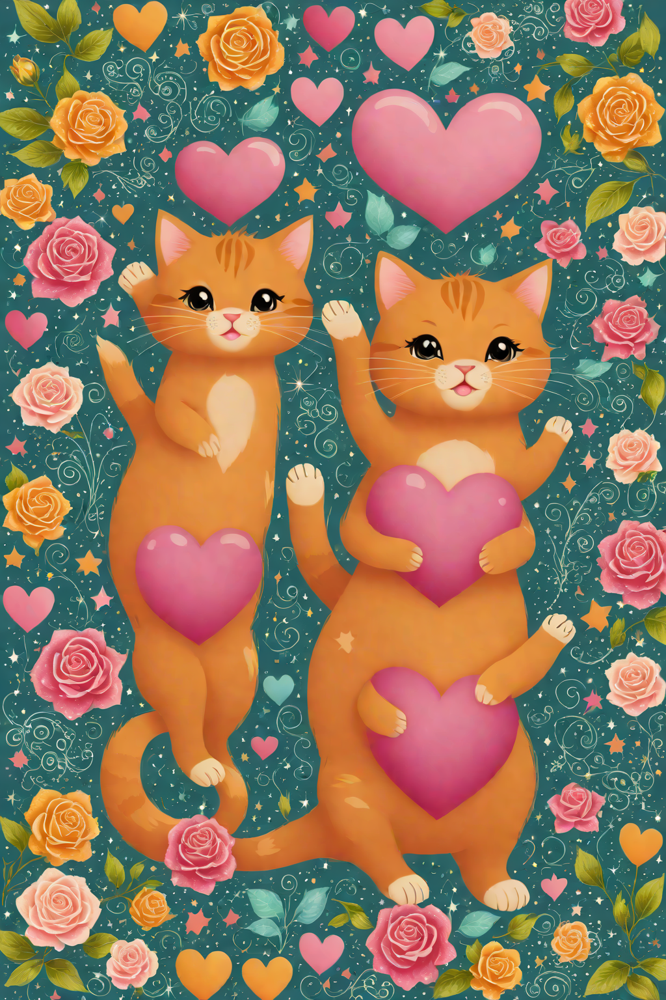

In [ ]:
import torch
from diffusers import StableDiffusionXLPipeline

pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/sdxl-turbo",
    torch_dtype=torch.float16,
    use_safetensors=True,
    add_watermarker=False,
).to("cuda")

pipe.load_lora_weights("Norod78/SDXL-StickerSheet-Lora",
                       weight_name="SDXL-StickerSheet-Lora.safetensors",
                       adapter_name="sticker")
pipe.load_lora_weights("AiWise/sdxl-faetastic-details_v24",
                       weight_name="SDXLFaeTastic2400.safetensors",
                       adapter_name="fae")
pipe.set_adapters({"sticker": 0.9, "fae": 0.6})

def gen_fast(prompt, outfile):
    image = pipe(
        prompt=prompt + ", StickerSheet, glitter, sparkles, high saturation",
        negative_prompt="text, letters, watermark, logo, low quality, blurry",
        num_inference_steps=4,
        guidance_scale=0.5,
        width=1024, height=1536,
    ).images[0]
    image.save(outfile)
    return image

gen_fast("cute orange kitten smiling and holding a big red heart, surrounded by pink roses and sparkles", "turbo_lora.png")


  0%|          | 0/4 [00:00<?, ?it/s]

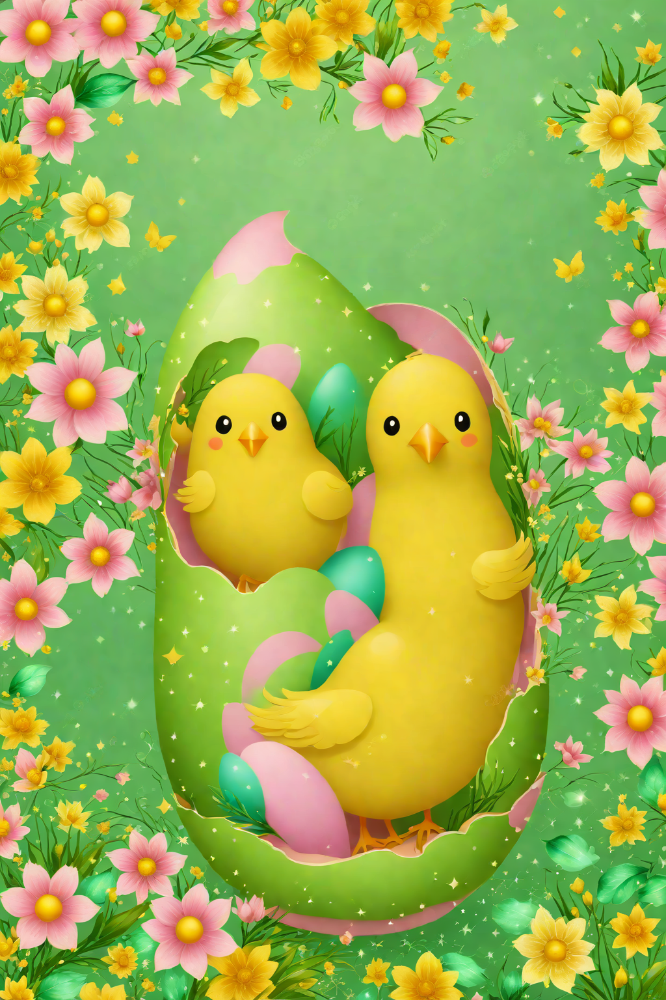

In [ ]:
gen_fast("yellow chick emerging from decorated egg shell, surrounded by spring flowers, pastel pink and green background, glitter sparkles, glossy highlights, photomontage postcard style, no text", "turbo_lora.png")

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


  0%|          | 0/4 [00:00<?, ?it/s]

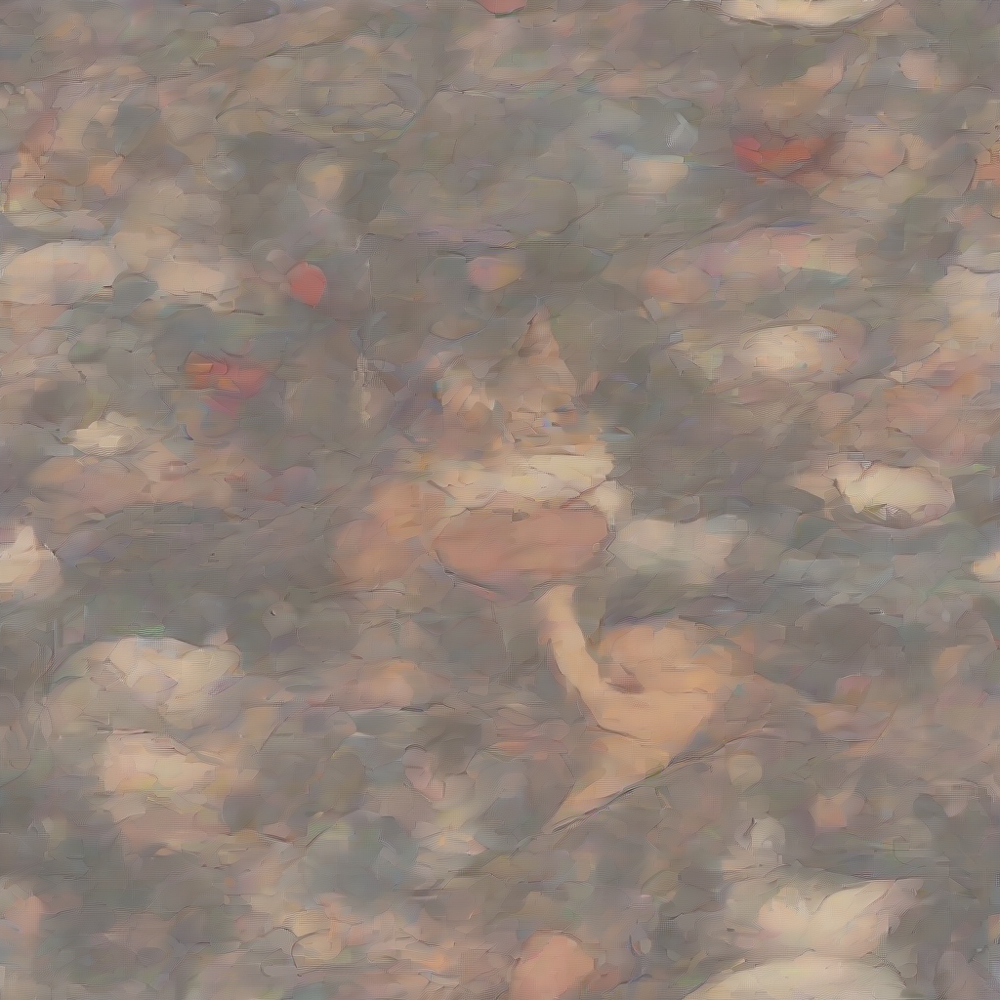

In [ ]:
import torch
from diffusers import StableDiffusionXLPipeline

pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True
).to("cuda")

prompt = "cute orange kitten smiling and holding a big red heart, surrounded by pink roses and sparkles"
image = pipe(prompt, num_inference_steps=4, guidance_scale=0.5).images[0]
image.save("image.png")
image


model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


  0%|          | 0/32 [00:00<?, ?it/s]

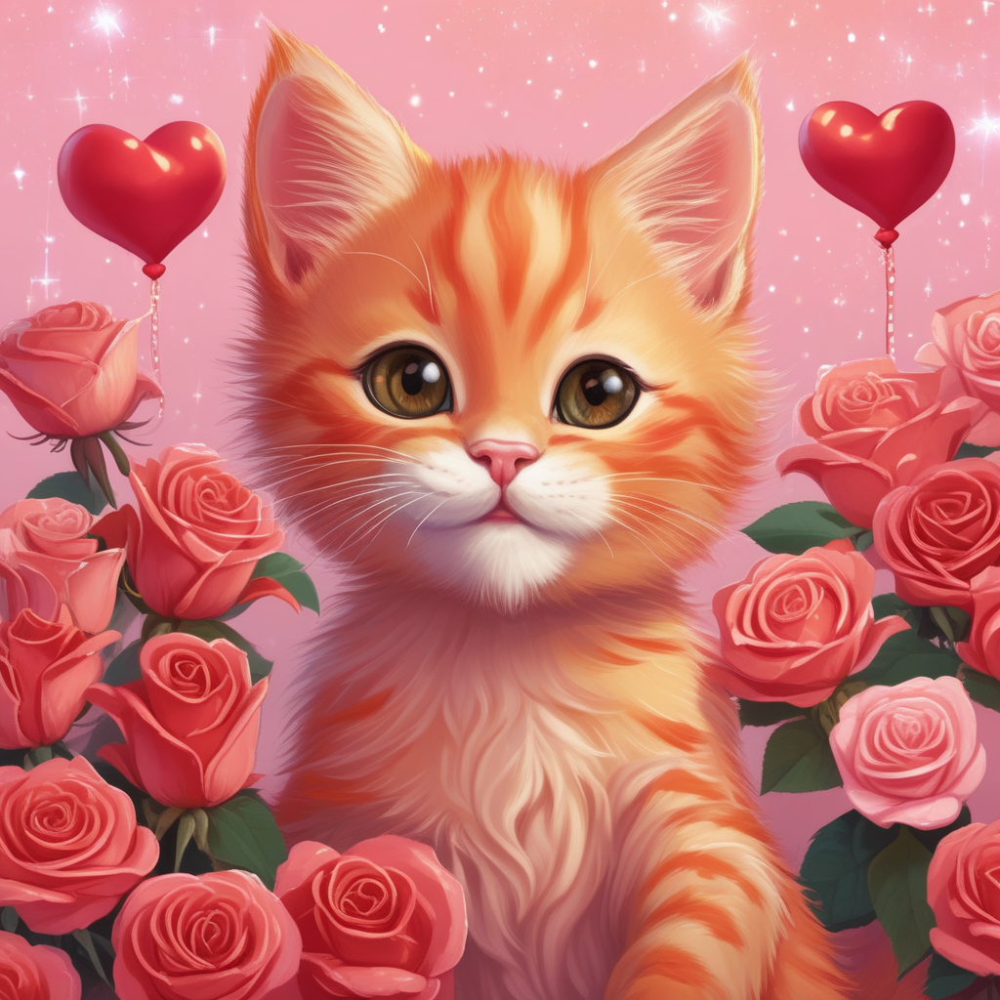

In [ ]:
import torch
from diffusers import StableDiffusionXLPipeline, DPMSolverMultistepScheduler

pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
    add_watermarker=False
).to("cuda")

# Scheduler
pipe.scheduler = DPMSolverMultistepScheduler.from_config(
    pipe.scheduler.config, use_karras=True
)

prompt = (
    "cute orange kitten smiling and holding a big red heart, "
    "surrounded by pink roses and sparkles"
)
negative = "text, letters, watermark, logo, low quality, blurry, jpeg artifacts"

img = pipe(
    prompt=prompt,
    negative_prompt=negative,
    num_inference_steps=32,
    guidance_scale=6.5
).images[0]

img.save("image.png")
img


  0%|          | 0/32 [00:00<?, ?it/s]

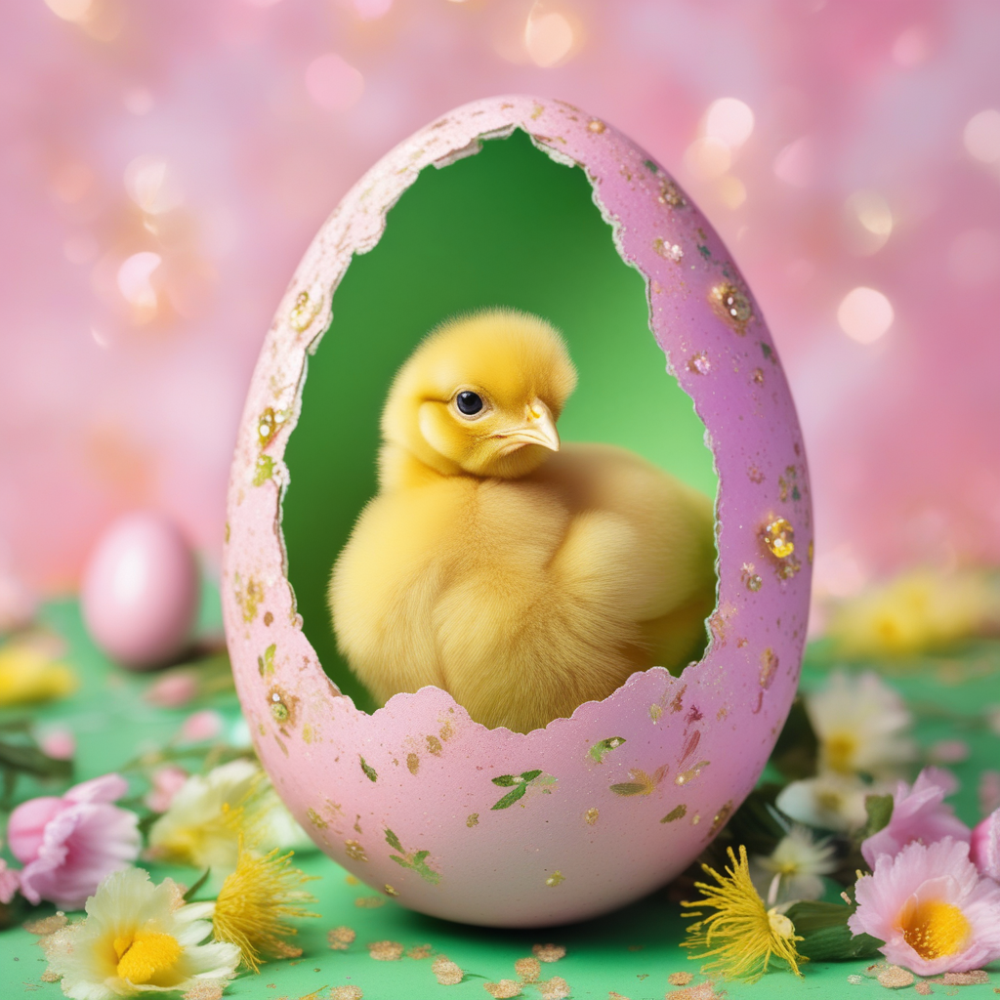

In [ ]:
prompt1 = (
    "yellow chick emerging from decorated egg shell, "
    "surrounded by spring flowers, pastel pink and green background, "
    "glitter sparkles, glossy highlights, photomontage postcard style, no text"
)
negative = "text, letters, watermark, logo, low quality, blurry, jpeg artifacts"

img = pipe(
    prompt=prompt1,
    negative_prompt=negative,
    num_inference_steps=32,
    guidance_scale=6.5
).images[0]

img.save("image.png")
img

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


SDXL-StickerSheet-Lora.safetensors:   0%|          | 0.00/29.0M [00:00<?, ?B/s]

SDXLFaeTastic2400.safetensors:   0%|          | 0.00/456M [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:196: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


  0%|          | 0/28 [00:00<?, ?it/s]

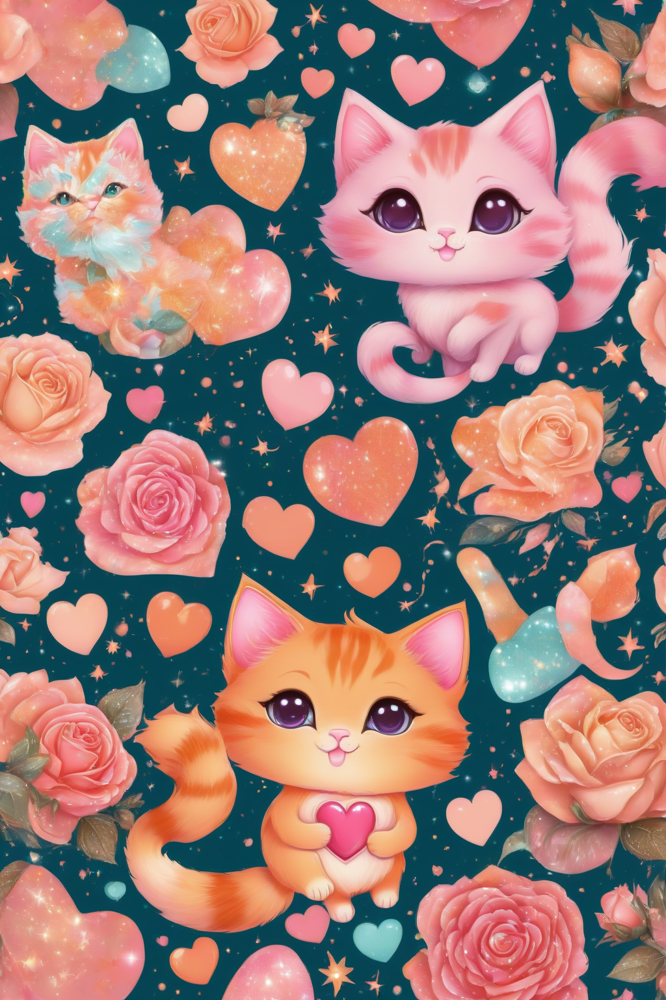

In [ ]:
import torch
from diffusers import StableDiffusionXLPipeline
device = "cuda"

pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
    add_watermarker=False,
).to(device)


# StickerSheet (stikers style)
pipe.load_lora_weights(
    "Norod78/SDXL-StickerSheet-Lora",
    weight_name="SDXL-StickerSheet-Lora.safetensors",
    adapter_name="sticker"
)
# FaeTastic (sparkles)
pipe.load_lora_weights(
    "AiWise/sdxl-faetastic-details_v24",
    weight_name="SDXLFaeTastic2400.safetensors",
    adapter_name="fae"
)

pipe.set_adapters({"sticker": 0.9, "fae": 0.7})

def gen(prompt, outfile):
    negative = (
        "text, letters, watermark, logo, low quality, blurry, artifacts, frame text"
    )
    image = pipe(
        prompt=prompt + ", StickerSheet, glitter, sparkles, bokeh, high saturation",
        negative_prompt=negative,
        num_inference_steps=28,
        guidance_scale=6.5,
        width=1024, height=1536,
    ).images[0]
    image.save(outfile)
    return image

prompt = "cute orange kitten smiling and holding a big red heart, surrounded by pink roses and sparkles"
gen(prompt, "image.png")


  0%|          | 0/28 [00:00<?, ?it/s]

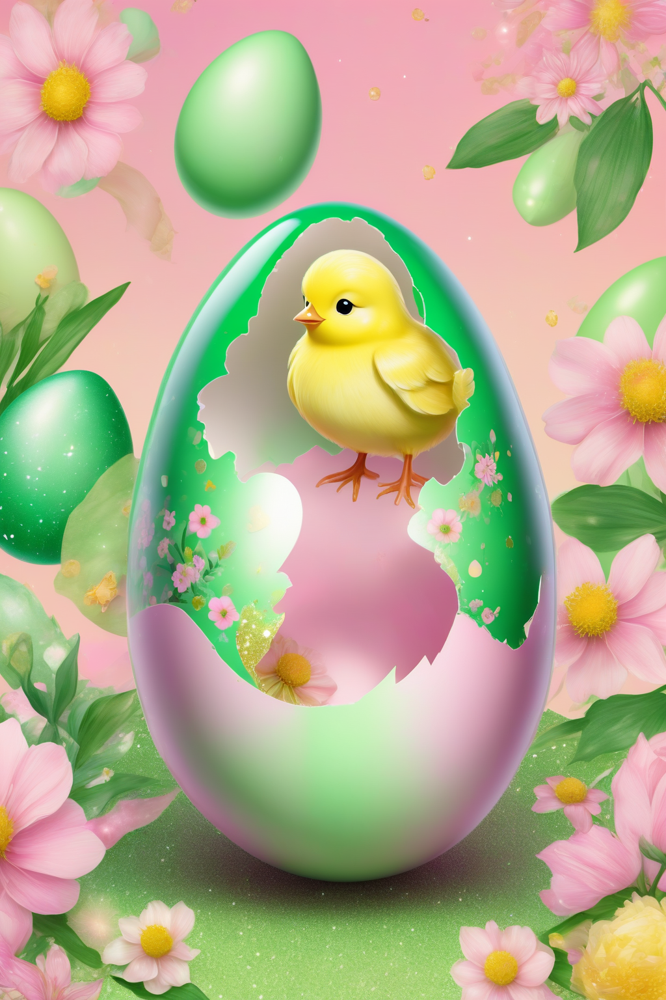

In [ ]:
prompt1 = "yellow chick emerging from decorated egg shell, surrounded by spring flowers, pastel pink and green background, glitter sparkles, glossy highlights, photomontage postcard style, no text"
gen(prompt1, "image.png")

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


SDXLFaeTastic2400.safetensors:   0%|          | 0.00/456M [00:00<?, ?B/s]

  0%|          | 0/32 [00:00<?, ?it/s]

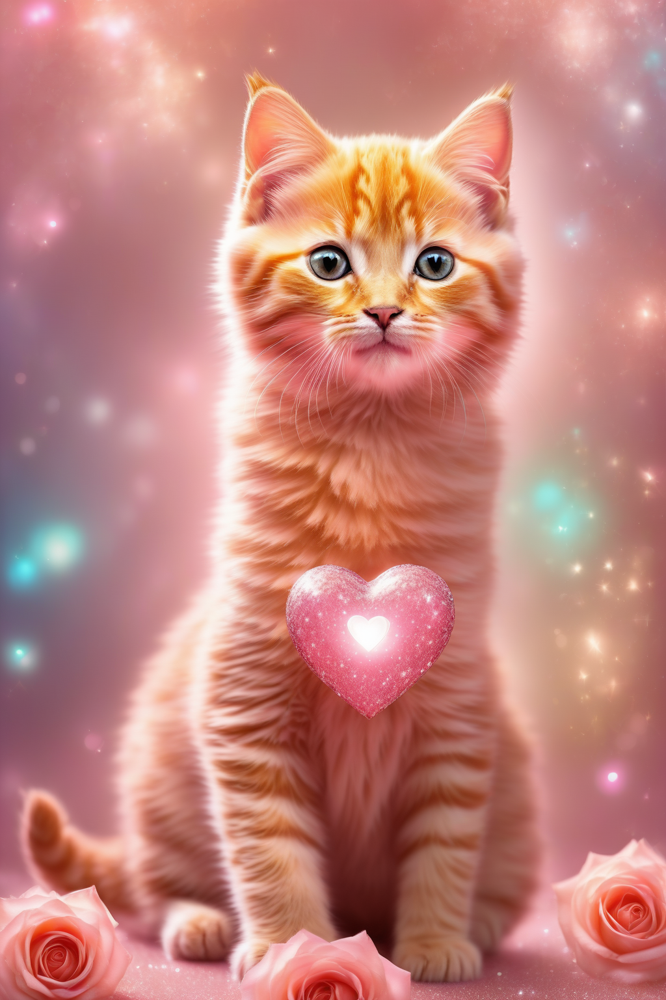

In [2]:
from diffusers import StableDiffusionXLPipeline
import torch

device="cuda"
pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16, use_safetensors=True, add_watermarker=False
).to(device)

pipe.load_lora_weights("AiWise/sdxl-faetastic-details_v24",
                       weight_name="SDXLFaeTastic2400.safetensors",
                       adapter_name="fae")
pipe.set_adapters({"fae": 0.55})

NEG = ("text, letters, watermark, logo, low quality, jpeg artifacts, "
       "vector, flat illustration, clipart, outline, extra head, extra eyes, fused features, deformed, bad anatomy")

def gen(prompt, file, steps=32, cfg=6.5, w=1024, h=1536, seed=1234):
    g = torch.Generator(device=device).manual_seed(seed)
    img = pipe(prompt=prompt, negative_prompt=NEG,
               num_inference_steps=steps, guidance_scale=cfg,
               width=w, height=h, generator=g).images[0]
    img.save(file); return img

prompt = (
 "single cute orange tabby kitten, full body, centered, soft fluffy fur, "
 "holding one big glossy pink heart, pastel pink gradient background with subtle roses and light bokeh, "
 "glitter sparkles, glossy highlights, high saturation, photomontage postcard look, no text"
)
gen(prompt, "card_cat_photomontage.png")


  0%|          | 0/32 [00:00<?, ?it/s]

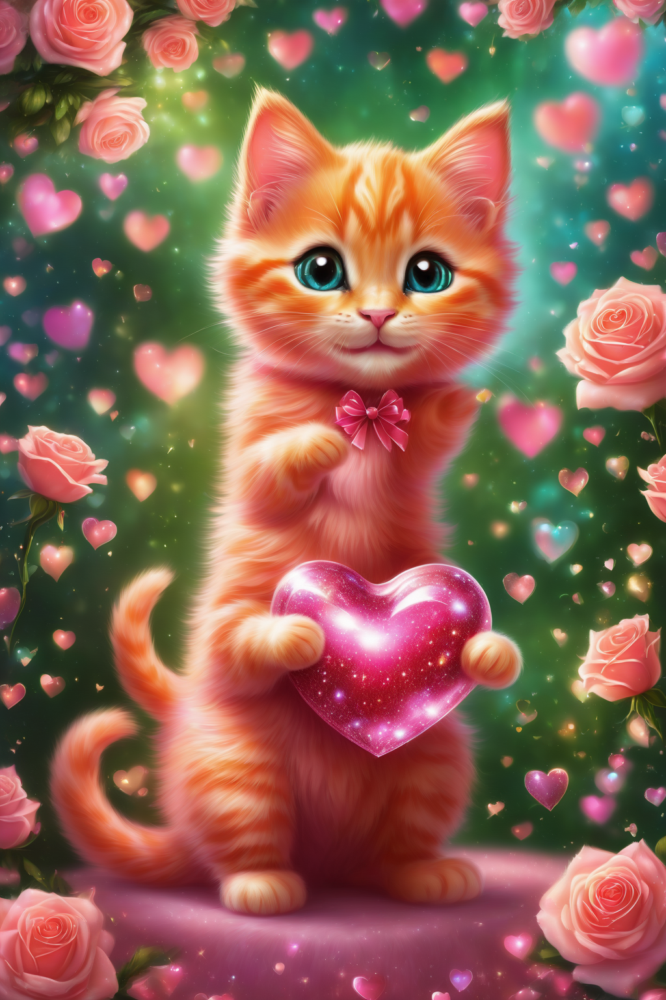

In [3]:
prompt1 = "cute orange kitten smiling and holding a big red heart, surrounded by pink roses and sparkles"
gen(prompt1, "image.png")

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


SDXLFaeTastic2400.safetensors:   0%|          | 0.00/456M [00:00<?, ?B/s]

SDXL-StickerSheet-Lora.safetensors:   0%|          | 0.00/29.0M [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:196: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


  0%|          | 0/32 [00:00<?, ?it/s]

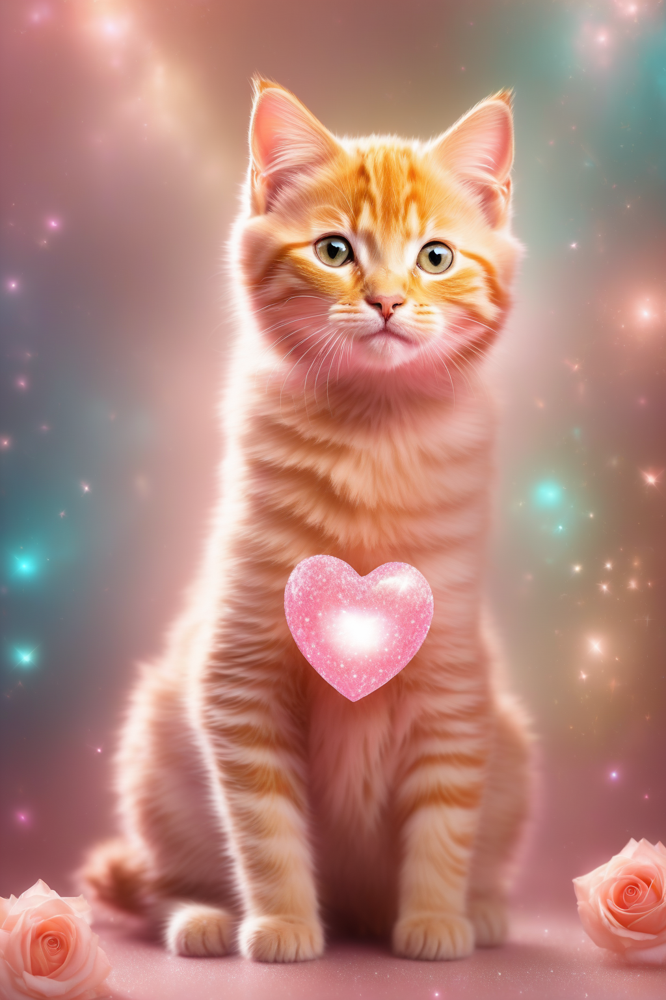

In [2]:
from diffusers import StableDiffusionXLPipeline
import torch

device="cuda"
pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16, use_safetensors=True, add_watermarker=False
).to(device)

pipe.load_lora_weights("AiWise/sdxl-faetastic-details_v24",
                       weight_name="SDXLFaeTastic2400.safetensors",
                       adapter_name="fae")
pipe.load_lora_weights("Norod78/SDXL-StickerSheet-Lora",
                       weight_name="SDXL-StickerSheet-Lora.safetensors",
                       adapter_name="sticker")
pipe.set_adapters({"sticker": 0.45, "fae": 0.35})

NEG = ("text, letters, watermark, logo, low quality, jpeg artifacts, "
       "hard outline, harsh vector, flat clipart, extra head, extra eyes, deformed")

def gen(prompt, file, steps=32, cfg=6.5, w=1024, h=1536, seed=1234):
    g = torch.Generator(device=device).manual_seed(seed)
    img = pipe(prompt=prompt, negative_prompt=NEG,
               num_inference_steps=steps, guidance_scale=cfg,
               width=w, height=h, generator=g).images[0]
    img.save(file); return img

prompt = (
 "single cute orange tabby kitten, full body, centered, soft fluffy fur, "
 "holding one big glossy pink heart, pastel pink gradient background with subtle roses and light bokeh, "
 "glitter sparkles, glossy highlights, high saturation, photomontage postcard look, no text"
)
gen(prompt, "card_cat_photomontage.png")


In [3]:
print(pipe.get_active_adapters())


{'sticker': 0.45, 'fae': 0.35}


In [3]:
from diffusers import StableDiffusionXLPipeline, DPMSolverMultistepScheduler
import torch

device = "cuda"
pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.float16,
    use_safetensors=True,
    add_watermarker=False,
).to(device)

pipe.scheduler = DPMSolverMultistepScheduler.from_config(pipe.scheduler.config, use_karras=True)

try:
    pipe.unload_lora_weights()
except Exception:
    pass

pipe.load_lora_weights("AiWise/sdxl-faetastic-details_v24",
                       weight_name="SDXLFaeTastic2400.safetensors",
                       adapter_name="fae")
pipe.load_lora_weights("Norod78/SDXL-StickerSheet-Lora",
                       weight_name="SDXL-StickerSheet-Lora.safetensors",
                       adapter_name="sticker")

pipe.set_adapters(["fae", "sticker"], adapter_weights=[0.35, 0.70])

print("active adapters:", pipe.get_active_adapters())
NEG = ("text, letters, watermark, logo, low quality, jpeg artifacts, "
       "hard outline, harsh vector, flat clipart, extra head, extra eyes, deformed")

"""prompt = (
 "single cute orange tabby kitten, full body, centered, soft fluffy fur, "
 "holding one big glossy pink heart, pastel pink gradient background with subtle roses and light bokeh, "
 "glitter sparkles, glossy highlights, high saturation, photomontage postcard look, no text"
)

for seed in [1234, 4321]:
    g = torch.Generator(device=device).manual_seed(seed)
    img = pipe(prompt=prompt, negative_prompt=NEG,
               num_inference_steps=32, guidance_scale=6.5,
               width=1024, height=1536, generator=g).images[0]
    img.save(f"cat_{seed}.png")
"""



model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

merges.txt: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

vocab.json: 0.00B [00:00, ?B/s]

text_encoder_2/model.safetensors:   0%|          | 0.00/2.78G [00:00<?, ?B/s]

text_encoder/model.safetensors:   0%|          | 0.00/492M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

vae_1_0/diffusion_pytorch_model.safetens(…):   0%|          | 0.00/335M [00:00<?, ?B/s]

unet/diffusion_pytorch_model.safetensors:   0%|          | 0.00/10.3G [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


SDXLFaeTastic2400.safetensors:   0%|          | 0.00/456M [00:00<?, ?B/s]

SDXL-StickerSheet-Lora.safetensors:   0%|          | 0.00/29.0M [00:00<?, ?B/s]

/usr/local/lib/python3.12/dist-packages/peft/tuners/tuners_utils.py:196: UserWarning: Already found a `peft_config` attribute in the model. This will lead to having multiple adapters in the model. Make sure to know what you are doing!
  warnings.warn(


active adapters: ['fae', 'sticker']


'prompt = (\n "single cute orange tabby kitten, full body, centered, soft fluffy fur, "\n "holding one big glossy pink heart, pastel pink gradient background with subtle roses and light bokeh, "\n "glitter sparkles, glossy highlights, high saturation, photomontage postcard look, no text"\n)\n\nfor seed in [1234, 4321]:\n    g = torch.Generator(device=device).manual_seed(seed)\n    img = pipe(prompt=prompt, negative_prompt=NEG,\n               num_inference_steps=32, guidance_scale=6.5,\n               width=1024, height=1536, generator=g).images[0]\n    img.save(f"cat_{seed}.png")\n'

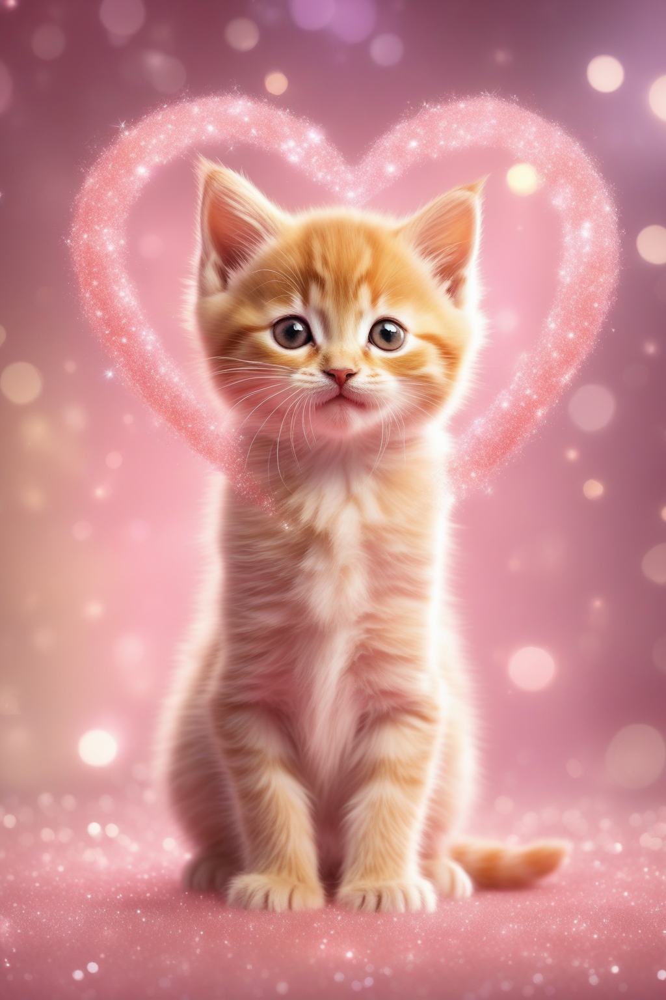

In [3]:
img

  0%|          | 0/32 [00:00<?, ?it/s]

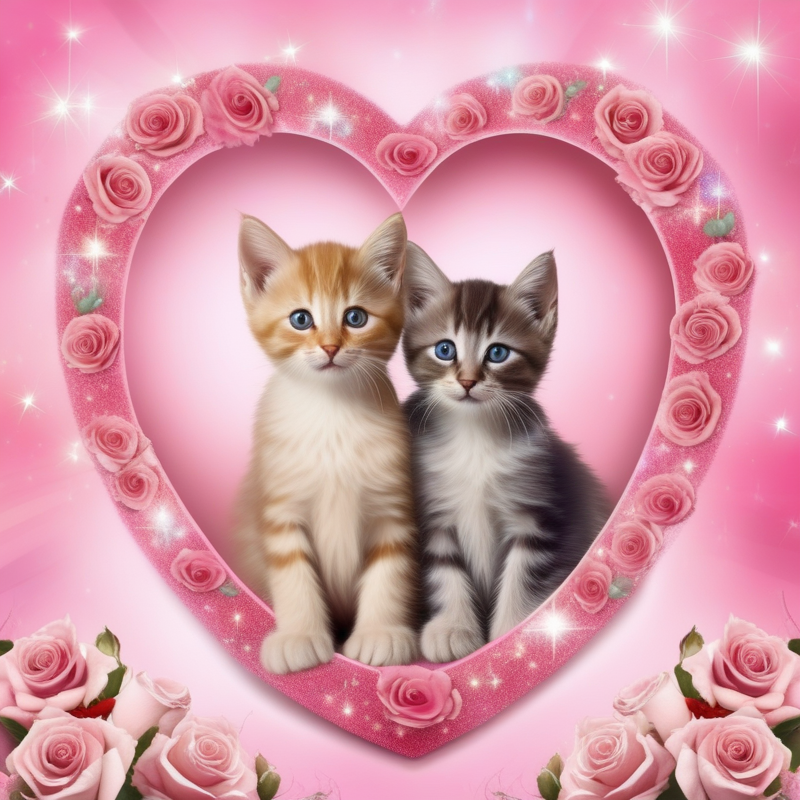

  0%|          | 0/32 [00:00<?, ?it/s]

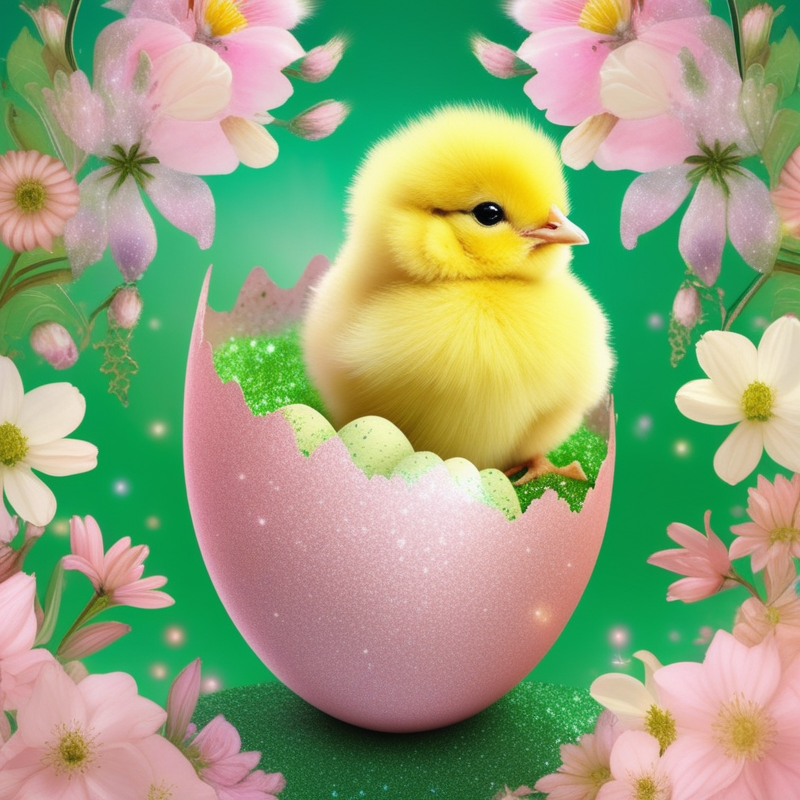

  0%|          | 0/32 [00:00<?, ?it/s]

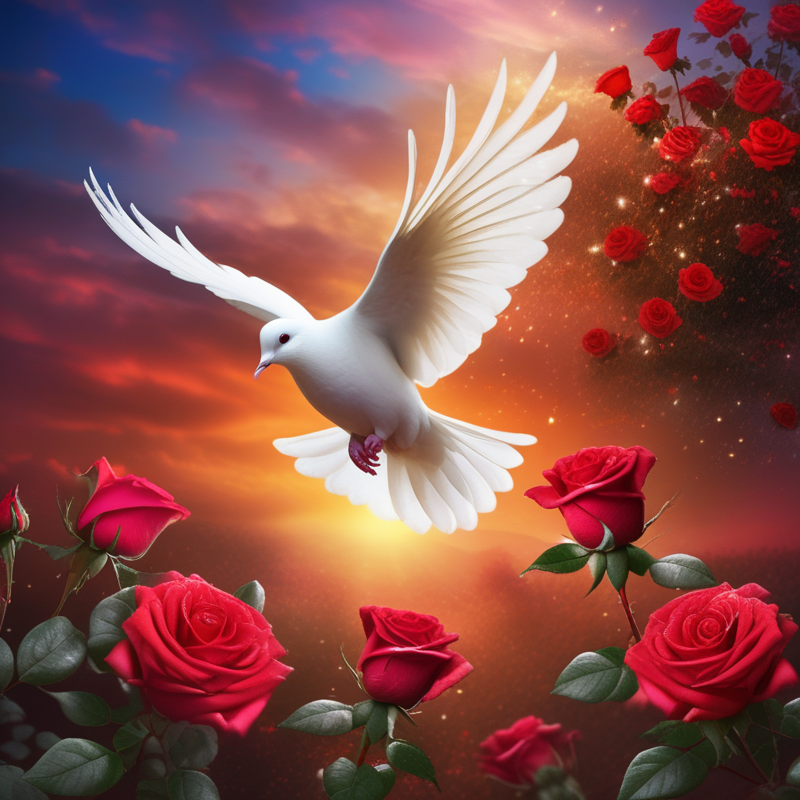

In [5]:
# continuously
from IPython.display import display

images = []
prompts = [
  "picture of two kittens sitting inside a big pink heart, sparkles and roses, pastel background, no text",
  "yellow chick emerging from decorated egg shell, surrounded by spring flowers, pastel pink and green background, glitter sparkles, glossy highlights, photomontage postcard style, no text",
  "white dove flying over red roses, glowing sunset, sparkles, high saturation, no text"
]

for i, p in enumerate(prompts, 1):
    g = torch.Generator(device=device).manual_seed(1000 + i)
    img = pipe(prompt=p, negative_prompt=NEG,
               num_inference_steps=32, guidance_scale=6.5,
               width=800, height=800, generator=g).images[0]
    img.save(f"card_{i}.png")
    images.append(img)
    display(img)



  0%|          | 0/32 [00:00<?, ?it/s]

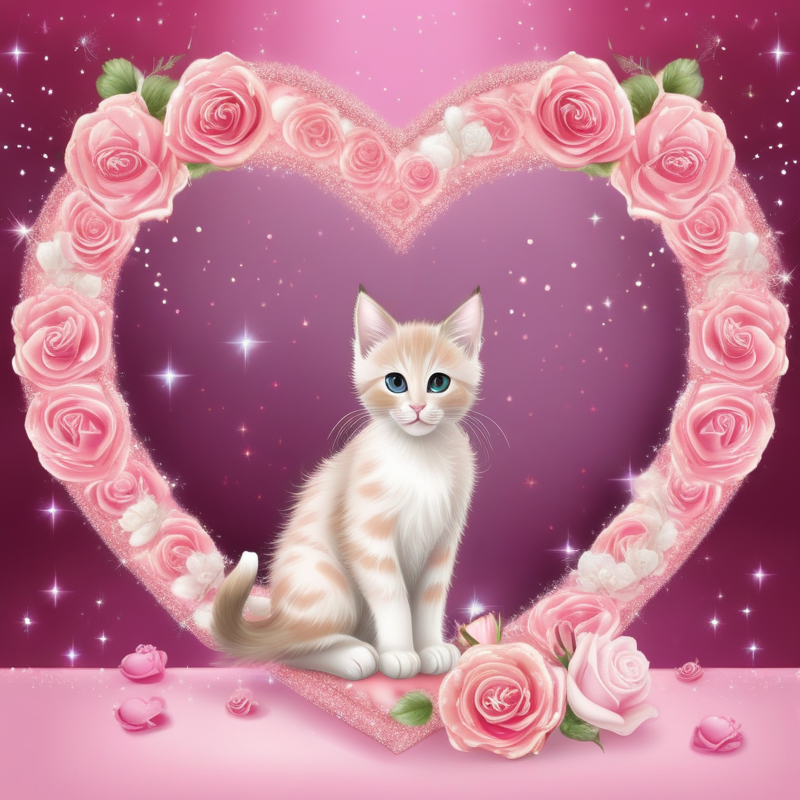

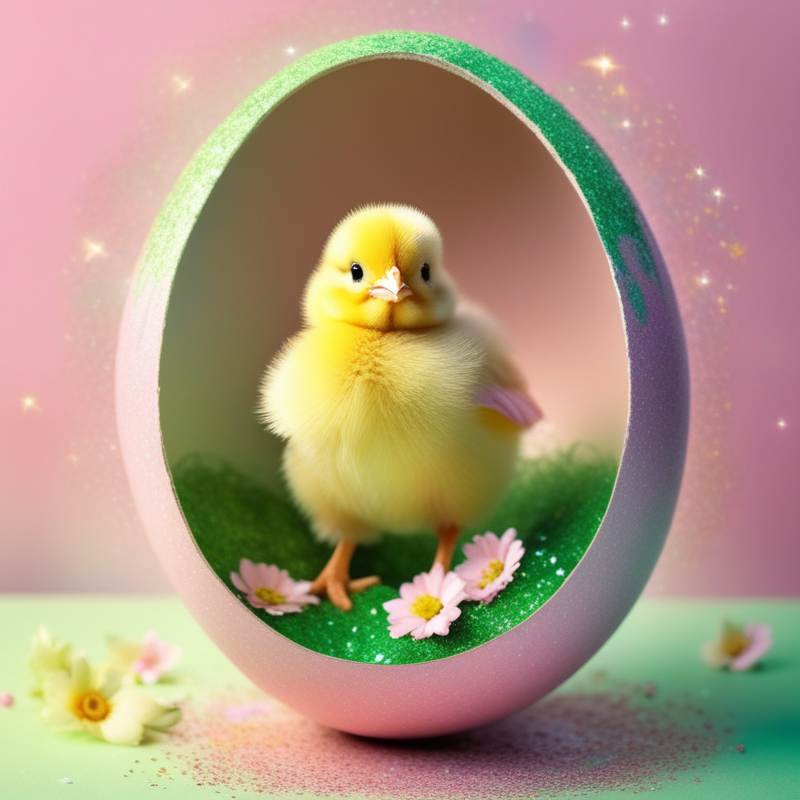

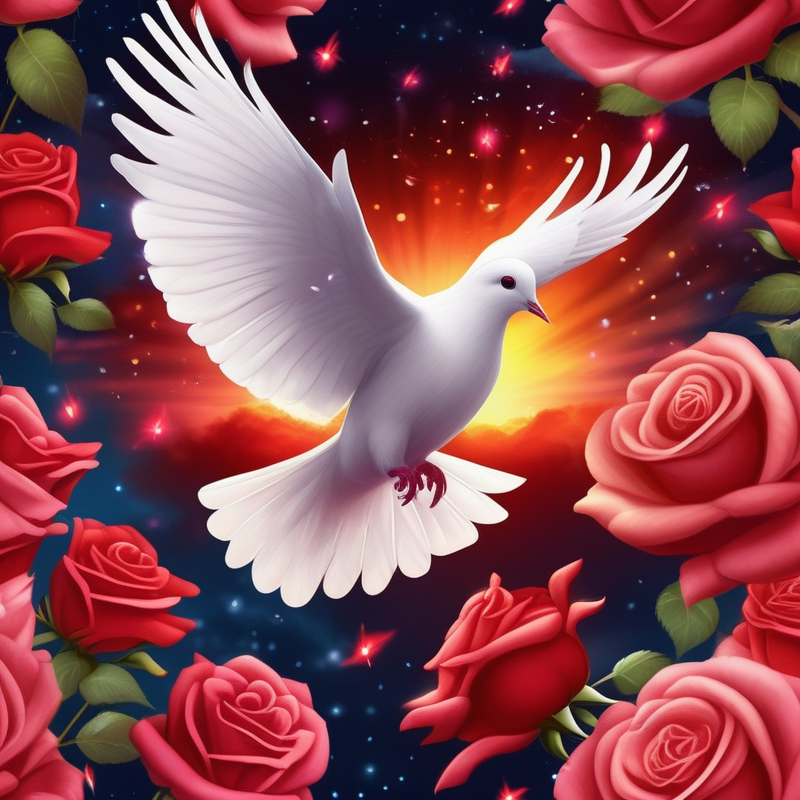

In [4]:
# parallel generating image with different prompts

prompts = [
  "picture of two kittens sitting inside a big pink heart, sparkles and roses, pastel background, no text",
  "yellow chick emerging from decorated egg shell, surrounded by spring flowers, pastel pink and green background, glitter sparkles, glossy highlights, photomontage postcard style, no text",
  "white dove flying over red roses, glowing sunset, sparkles, high saturation, no text"
]

batch_prompts = prompts
batch_neg = [NEG] * len(batch_prompts)
gens = [torch.Generator(device=device).manual_seed(1000 + i) for i in range(len(batch_prompts))]

out = pipe(
    prompt=batch_prompts,
    negative_prompt=batch_neg,
    num_inference_steps=32,
    guidance_scale=6.5,
    width=800, height=800,
    generator=gens
)
for i, img in enumerate(out.images, 1):
    img.save(f"card_paral_{i}.png")
    display(img)


In [ ]:
# parallel
prompts = [
  "picture of two kittens sitting inside a big pink heart, sparkles and roses, pastel background, no text",
  "yellow chick emerging from decorated egg shell, surrounded by spring flowers, pastel pink and green background, glitter sparkles, glossy highlights, photomontage postcard style, no text",
  "white dove flying over red roses, glowing sunset, sparkles, high saturation, no text"
]


def chunks(lst, n):
    for i in range(0, len(lst), n):
        yield lst[i:i+n]

for k, chunk_prompts in enumerate(chunks(prompts, 2), 1):
    gens = [torch.Generator(device=device).manual_seed(2000+i) for i in range(len(chunk_prompts))]
    out = pipe(prompt=chunk_prompts,
               negative_prompt=[NEG]*len(chunk_prompts),
               num_inference_steps=28,
               guidance_scale=6.2,
               width=800, height=800,
               generator=gens)
    for j, img in enumerate(out.images, 1):
        img.save(f"card_batch{k}_{j}.png")
        display(img)
    torch.cuda.empty_cache()
